In [138]:
import math
import cv2
import numpy as np
import os
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd
DEBUG = True
THRESHOLD_BINARY = 170
SAVEGAMMA = 0.7

In [2]:
# Break up data into consecutive groups.
def consecutive_groups(x, stepsize=1):
    return [ i for i in range(1, len(x), stepsize) if x[i] != x[i-1] ]

In [34]:
def rotate_image(img, angle):
        (h, w) = img.shape[:2]
        center = (w // 2, h // 2)
        M = cv2.getRotationMatrix2D(center, angle, 1.0)
        rotated = cv2.warpAffine(img.copy(), M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
        return rotated

In [3]:
def adjust_gamma(image, gamma=1.0):
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255
        for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

In [134]:
def get_horz_vert(inpath, kernel, erosion_iterations, gamma=1.0):
        img = cv2.imread(inpath, cv2.IMREAD_GRAYSCALE)
        img = adjust_gamma(img, gamma) if gamma != 1.0 else img
        ret, thresh = cv2.threshold(img.copy(), THRESHOLD_BINARY, 255, cv2.THRESH_BINARY)
        eroded = cv2.erode(thresh, kernel, iterations = erosion_iterations)
        horizontal = consecutive_groups(eroded[0])
        vertical = consecutive_groups(np.transpose(eroded)[0])
        return horizontal, vertical

In [5]:
def save_cropped(inpath, outpath, y1, y2, x1, x2):
    img = cv2.imread(inpath)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    framed = img[y1:y2, x1:x2]
    z = Image.fromarray(framed)
    z.save(outpath)

In [107]:
def getangle(pt1, pt2):
        x1, y1 = pt1
        x2, y2 = pt2
        return np.rad2deg(np.arctan2(y2 - y1, x2 - x1))

In [105]:
def getangle_lines(eroded):
        angles = []
        height, width = np.shape(eroded)

        # Make np array and transposed to process vertical and horizontal lines.
        a = np.array(eroded)
        b = np.transpose(a)

        # Do this for both vertical and horizontal.
        for x in [a, b]:
                multiplier = 1 if len(x[0]) == width else -1 # 1 for normal, -1 for transposed.
                top = consecutive_groups(x[0])
                bottom = consecutive_groups(x[-1])

                # Only look at the first and last pair.
                for i in [0, 1, -2, -1]:
                        angle = multiplier * (getangle((top[i], 0), (bottom[i], len(x))) - 90) if top and bottom else 0
                        # Only take angles < 2 degrees.
                        angles.append(angle) if abs(angle) < 2 else None

        avg_angle = sum(angles)/len(angles)

        print(avg_angle, angles) if DEBUG else None
        return avg_angle

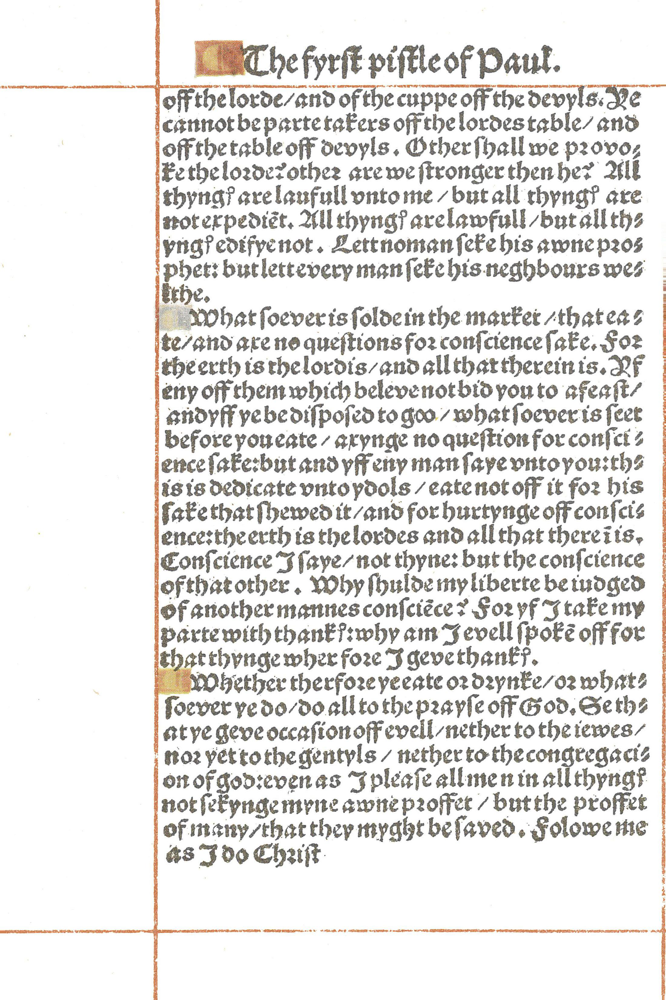

In [352]:
inpath = '2.rotated/12.1corinthians.0000020.jpg'

img = cv2.imread(inpath)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = rotate_image(img, 0)
Image.fromarray(img)

-0.14385917770653123 [-0.12153631971177958, -0.12153631971177958, -0.12153631971177958, -0.12153631971177958, -0.13021745650824812, -0.2083473708062087, -0.18230413778414345]


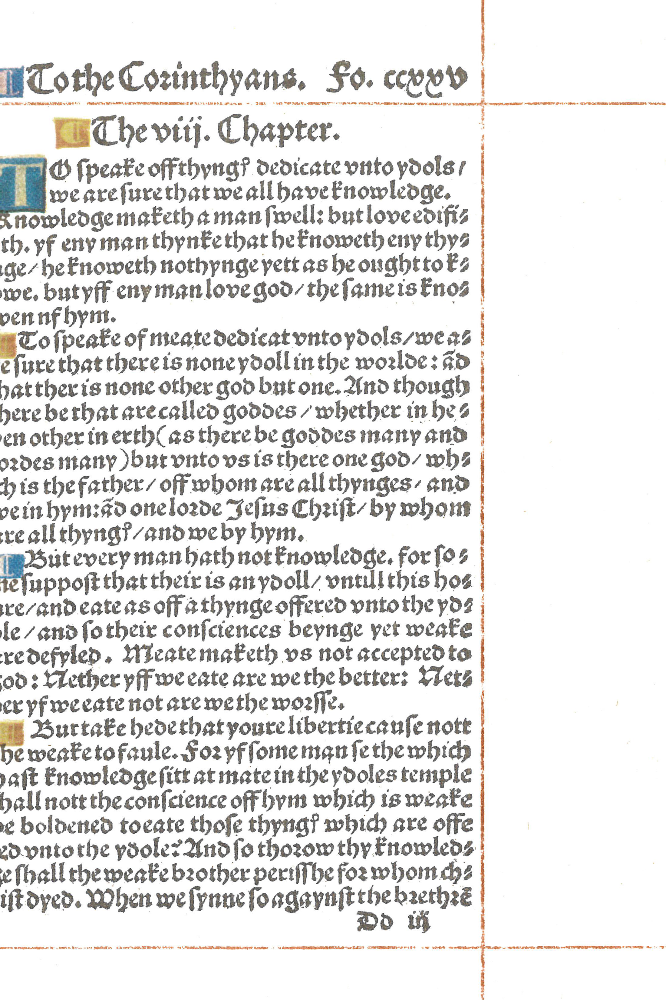

In [367]:
inpath = '1.cropped/12.1corinthians.0000015.jpg'
ksize = 5
kernel_size = (ksize, ksize)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
erosion_iterations = 10
    
img = cv2.imread(inpath, cv2.IMREAD_GRAYSCALE)
#img = adjust_gamma(img, 0.5)

ret, thresh = cv2.threshold(img, 170, 255, cv2.THRESH_BINARY)
eroded = cv2.erode(thresh, kernel, iterations=erosion_iterations)
Image.fromarray(thresh)
angle = getangle_lines(eroded)
#angle = 0.1

img = cv2.imread(inpath)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rotated = rotate_image(img, angle)

Image.fromarray(rotated)

19.titus_philemon.0000002.jpg - using gamma
!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!  FAILED  19.titus_philemon.0000002.jpg [226, 277, 1888, 1937] [280, 329]


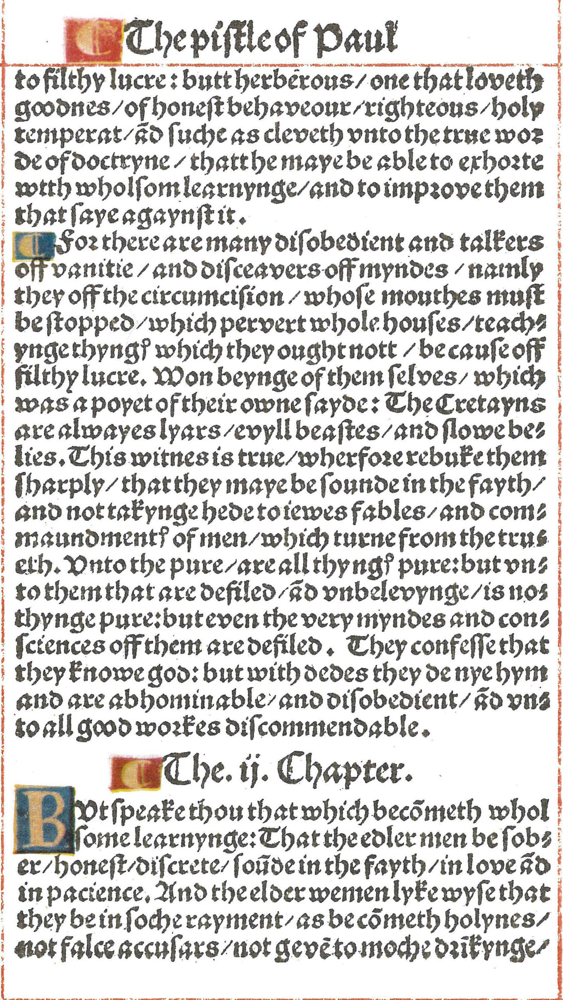

In [381]:
ksize = 5
kernel_size = (ksize, ksize)
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
erosions = 10

moveup = 170
padding = 15
docwidth = 1712
docheight = 2832

f = '2.rotated/19.titus_philemon.0000002.jpg'
filename = f.split('/')[-1]
outpath = '3.final/{}'.format(filename)

horizontal, vertical = get_horz_vert(f, kernel, erosions)

# If failed, decrease gamma.
if len(horizontal) < 4 or len(vertical) < 4:
        print('{} - using gamma'.format(filename))
        horizontal, vertical = get_horz_vert(f, kernel, erosions, gamma=0.7)

# Get the first item from horz and vert.
x, y = horizontal[0], vertical[0]

# # By this point we should be within range of these conditions.
if (len(horizontal) >= 4 and len(vertical) >= 4 and x < 500 and y < 500):
        print('x, y, horz, vert: {}, {}, {}, {}'.format(x, y, horizontal, vertical))
else:
        print('!'*40, ' FAILED ', filename, horizontal, vertical)

#x, y = 140, 307
img = cv2.imread(f)
img = adjust_gamma(img, SAVEGAMMA) if SAVEGAMMA != 1.0 else img
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
y1 = y-moveup
y2 = y+docheight-padding
x1 = x+padding
x2 = x+docwidth-padding
framed = img[y1:y2, x1:x2]
Image.fromarray(framed)